<a href="https://colab.research.google.com/github/ACoolA-008/Data_Science_Projects/blob/main/Video_Labeling.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [55]:
import pandas as pd
import numpy as np
import cv2
import matplotlib.pyplot as plt

from glob import glob
import IPython.display as ipd
from tqdm.notebook import tqdm # track images

import subprocess # run command lines

In [56]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [57]:
import os
os.environ['KAGGLE_CONFIG_DIR'] = "/content/drive/MyDrive/Kaggle"

In [58]:
%cd /content/drive/MyDrive/Kaggle/Mot_Labels_Video_Analytics

/content/drive/MyDrive/Kaggle/Mot_Labels_Video_Analytics


In [59]:
# !kaggle datasets download -d robikscube/driving-video-with-object-tracking

In [60]:
# ! unzip driving-video-with-object-tracking.zip

In [61]:
# Convert mov file into mp4 file

input_file = '/content/drive/MyDrive/Kaggle/Mot_Labels_Video_Analytics/bdd100k_videos_train_00/bdd100k/videos/train/026c7465-309f6d33.mov'

subprocess.run(['ffmpeg','-i', input_file,
                '-qscale','0',
                '026c7465-309f6d33.mp4'])

CompletedProcess(args=['ffmpeg', '-i', '/content/drive/MyDrive/Kaggle/Mot_Labels_Video_Analytics/bdd100k_videos_train_00/bdd100k/videos/train/026c7465-309f6d33.mov', '-qscale', '0', '026c7465-309f6d33.mp4'], returncode=1)

In [62]:
!ls -l # check if mp4 is created

total 20204547
-rw------- 1 root root    13868822 Jan 17 02:18 026c7465-309f6d33.mp4
drwx------ 3 root root        4096 Jan 17 02:03 bdd100k_videos_train_00
-rw------- 1 root root 19942271205 Jun  1  2022 driving-video-with-object-tracking.zip
-rw------- 1 root root   462806153 Jun  1  2022 mot_labels.csv
-rw------- 1 root root    86850400 Jan 17 00:28 mot_labels.csv.zip
-rw------- 1 root root    78516663 Jun  1  2022 mot_labels.parquet
-rw------- 1 root root    30218663 Jan 17 03:51 out_test_compressed.mp4
-rw------- 1 root root    74918288 Jan 17 03:50 out_test.mp4


In [63]:
# watch the selected video

# ipd.Video("026c7465-309f6d33.mp4", width=700)

In [64]:
# watch the selected video

from IPython.display import HTML
from base64 import b64encode
mp4 = open('026c7465-309f6d33.mp4','rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML("""
<video width=700 controls>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)

# Open the Video and Read Metadata

In [65]:
# !pip uninstall opencv-python
# !pip uninstall opencv-contrib-python

In [66]:
# pip install opencv-python
# !pip install opencv-contrib-python

In [67]:
cap = cv2.VideoCapture('026c7465-309f6d33.mp4')

In [68]:
height = cap.get(cv2.CAP_PROP_FRAME_HEIGHT)
width = cap.get(cv2.CAP_PROP_FRAME_WIDTH)
print(f"Height {height}, Width {width}")

Height 720.0, Width 1280.0


In [69]:
# frames per second

fps = cap.get(cv2.CAP_PROP_FPS)
print(f"FPS: {fps}")
print(f"FPS: {fps:0.2f}") # keep 2 decimals

FPS: 59.94005994005994
FPS: 59.94


In [70]:
cap.release() # release

# Pullnig Images from the Video

In [71]:
cap = cv2.VideoCapture('026c7465-309f6d33.mp4')

In [72]:
return_result, img = cap.read() # read the mp4 video in images
print(f"Returned Result is: {return_result} \nimg shape is: {img.shape}")

Returned Result is: True 
img shape is: (720, 1280, 3)


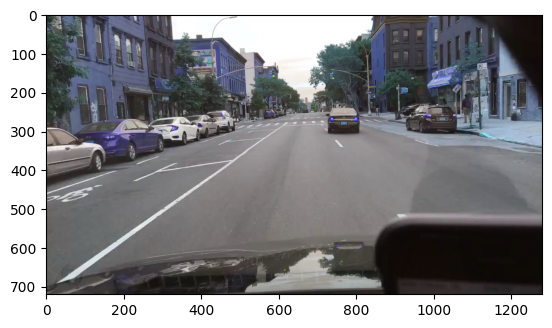

In [73]:
# show an image in the mp4 video

plt.imshow(img)

In [74]:
def display_cv2_img(img, figsize=(10,10)):
  """
  The above image is formated in BGR channels.
  We want to convert it into RGB channels for a better visualization.
  """
  img_ = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
  fig, ax = plt.subplots(figsize=figsize)
  ax.imshow(img_)
  ax.axis('off')

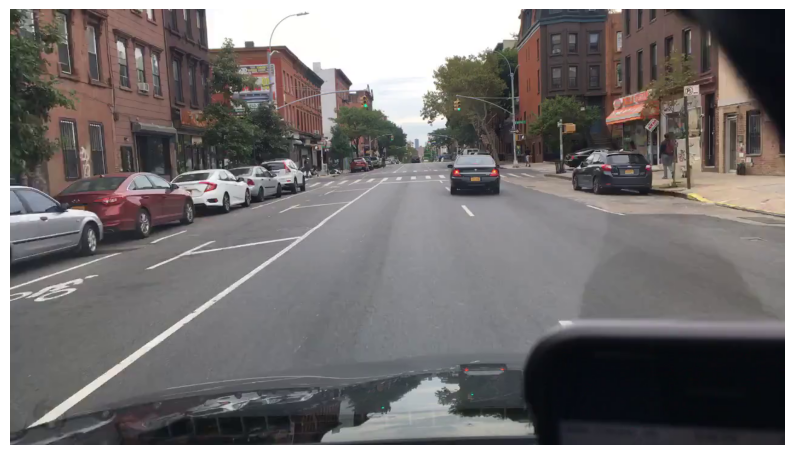

In [75]:
display_cv2_img(img)

In [76]:
cap.release()

# Display Multiple Frames from the Video

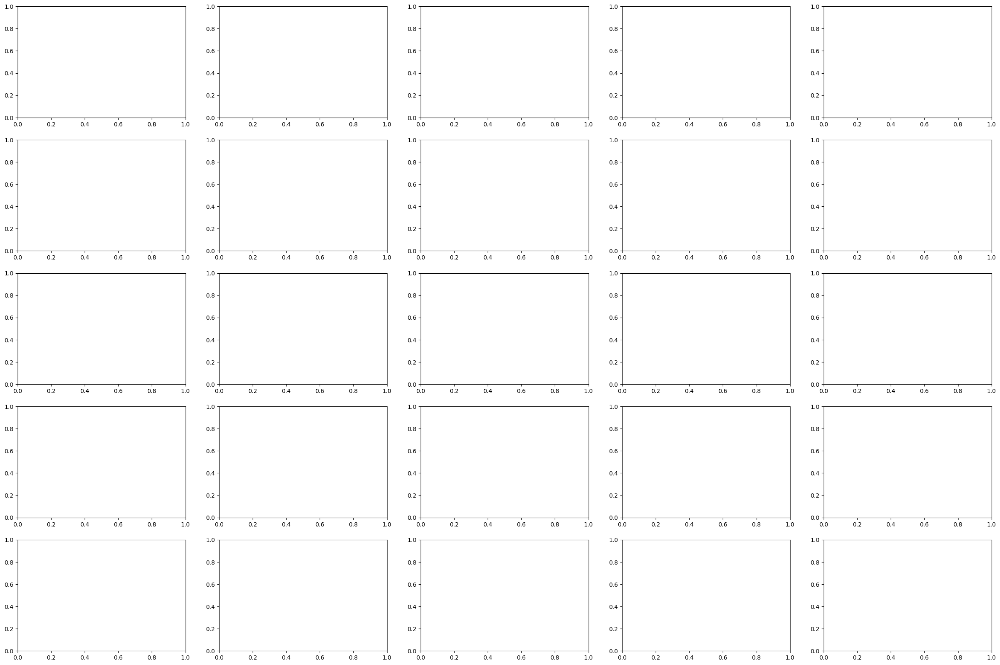

In [77]:
fig, axs = plt.subplots(5,5, figsize=(30,20))
axs = axs.flatten()
plt.show()

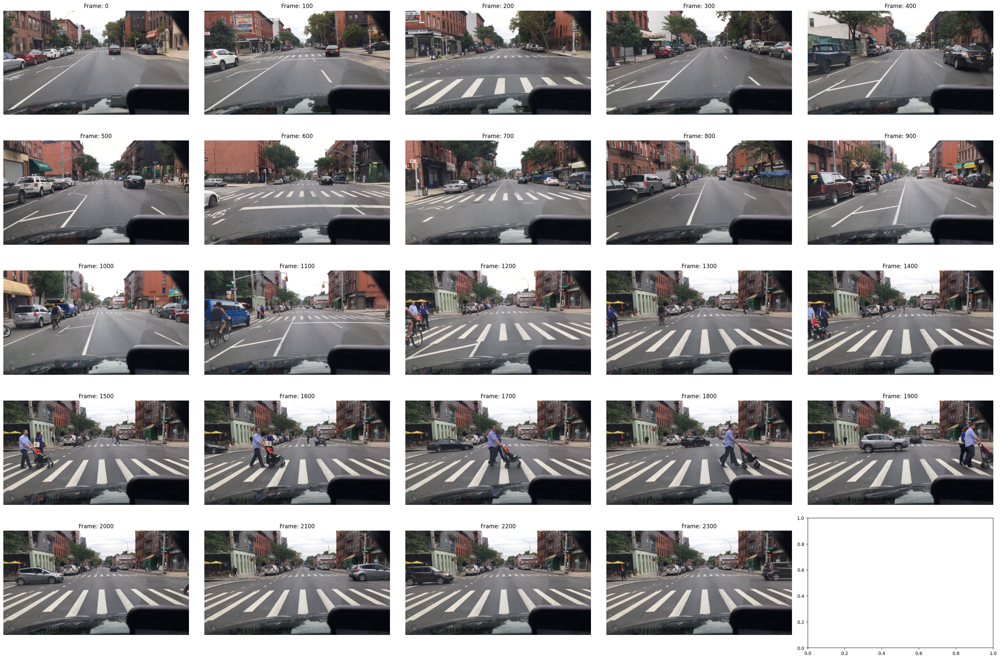

In [78]:
fig, axs = plt.subplots(5,5, figsize=(30,20))
axs = axs.flatten()

cap = cv2.VideoCapture('026c7465-309f6d33.mp4')
number_of_frames = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))


img_idx = 0
for frame in range(number_of_frames):
  return_result, img = cap.read()
  if return_result == False:
    break
  if frame % 100 == 0:
    axs[img_idx].imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    axs[img_idx].set_title(f"Frame: {frame}")
    axs[img_idx].axis('off')
    img_idx += 1

plt.tight_layout()
plt.show()
cap.release()

# Adding Annotations to the Video Images

In [79]:
labels = pd.read_csv("/content/drive/MyDrive/Kaggle/Mot_Labels_Video_Analytics/mot_labels.csv",
                     low_memory=False)

In [80]:
labels.head()

,name,videoName,frameIndex,id,category,attributes.crowd,attributes.occluded,attributes.truncated,box2d.x1,box2d.x2,box2d.y1,box2d.y2,haveVideo
0,01c71072-718028b8-0000001.jpg,01c71072-718028b8,0,89537.0,car,False,True,False,825.173210,1003.094688,355.011547,418.198614,True
1,01c71072-718028b8-0000001.jpg,01c71072-718028b8,0,89538.0,car,False,True,False,484.295612,700.461894,346.697460,424.849885,True
2,01c71072-718028b8-0000001.jpg,01c71072-718028b8,0,89539.0,pedestrian,False,True,False,645.588915,663.879908,338.383372,358.337182,True
3,01c71072-718028b8-0000001.jpg,01c71072-718028b8,0,89540.0,car,False,False,False,120.969977,192.471132,359.168591,409.053118,True
4,01c71072-718028b8-0000001.jpg,01c71072-718028b8,0,89541.0,car,False,False,False,251.501155,315.519630,354.180139,400.739030,True


In [81]:
video_labels = (
    labels.query('videoName == "026c7465-309f6d33"').reset_index(drop=True).copy()
)


# The video is at 60 frames
# label dataset labels frame at 5 hz
video_labels['video_frame'] = (video_labels['frameIndex']*11.9).round().astype('int')

In [82]:
video_labels['category'].value_counts()

car              3030
pedestrian        847
bicycle           381
rider             320
truck             194
other vehicle     115
bus               109
other person       74
motorcycle         67
trailer            34
Name: category, dtype: int64

In [83]:
# Pull an image from frame 1035

cap = cv2.VideoCapture('026c7465-309f6d33.mp4')
number_of_frames = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))

img_idx = 0
for frame in range(number_of_frames):
  return_result, img = cap.read()
  if return_result == False:
    break
  if frame == 1035:
    break

cap.release()
plt.show()

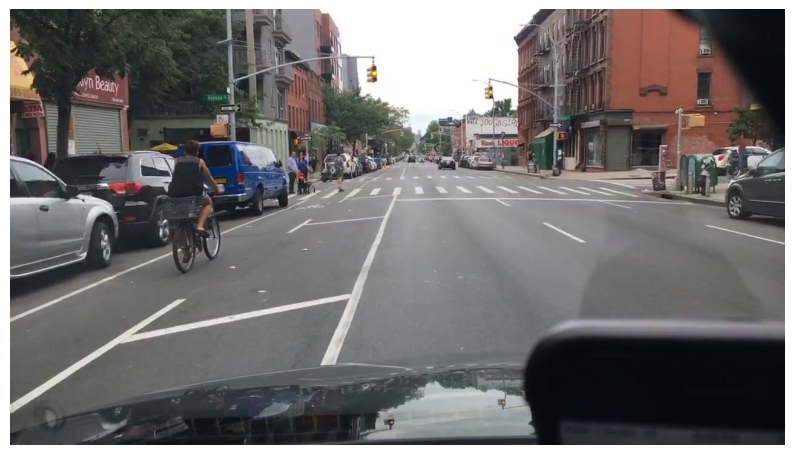

In [84]:
display_cv2_img(img)

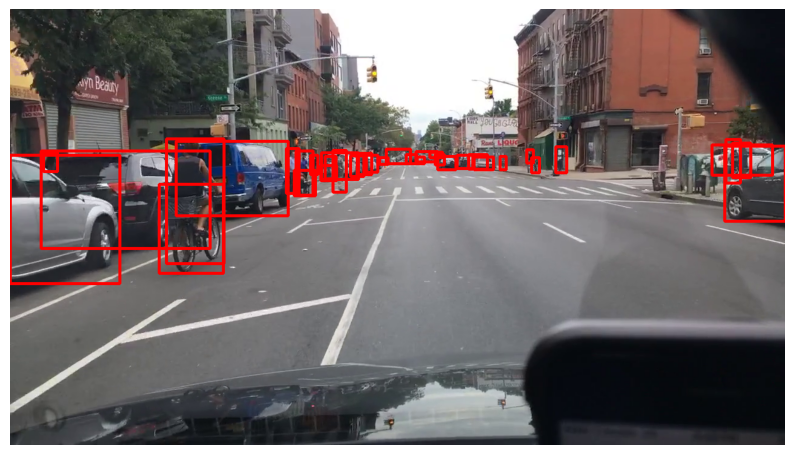

In [85]:
frame_labels = video_labels.query('video_frame == 1035')

for i, d in frame_labels.iterrows():
  point1 = int(d['box2d.x1']), int(d['box2d.y1'])
  point2 = int(d['box2d.x2']), int(d['box2d.y2'])
  cv2.rectangle(img, point1, point2, (0,0,255), 3)

display_cv2_img(img)

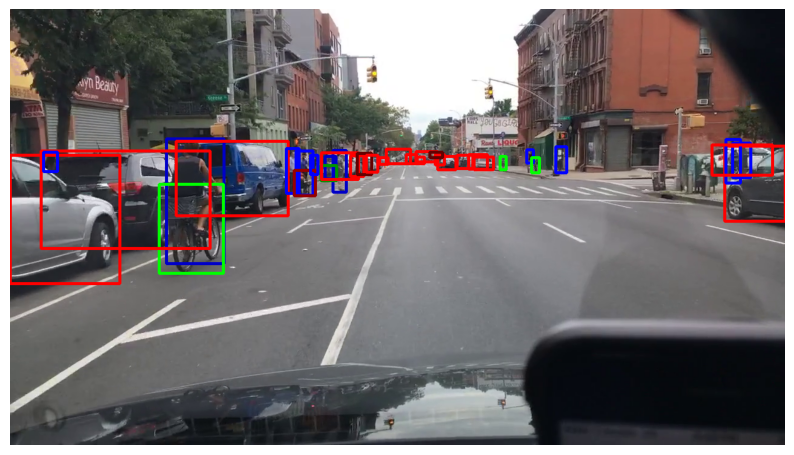

In [86]:
color_map = {
    "car": (0, 0, 255),
    "truck": (0, 0, 100),
    "pedestrian": (255, 0, 0),
    "other vehicle": (0, 0, 150),
    "rider": (200, 0, 0),
    "bicycle": (0, 255, 0),
    "other person": (200, 0, 0),
    "trailer": (0, 150, 150),
    "motorcycle": (0, 150, 0),
    "bus": (0, 0, 100),
}


img_example = img.copy()
frame_labels = video_labels.query('video_frame == 1035')

for i, d in frame_labels.iterrows():
  point1 = int(d['box2d.x1']), int(d['box2d.y1'])
  point2 = int(d['box2d.x2']), int(d['box2d.y2'])
  color = color_map[d['category']]
  cv2.rectangle(img_example, point1, point2, color, 3)

display_cv2_img(img_example)


# Adding Text Labels

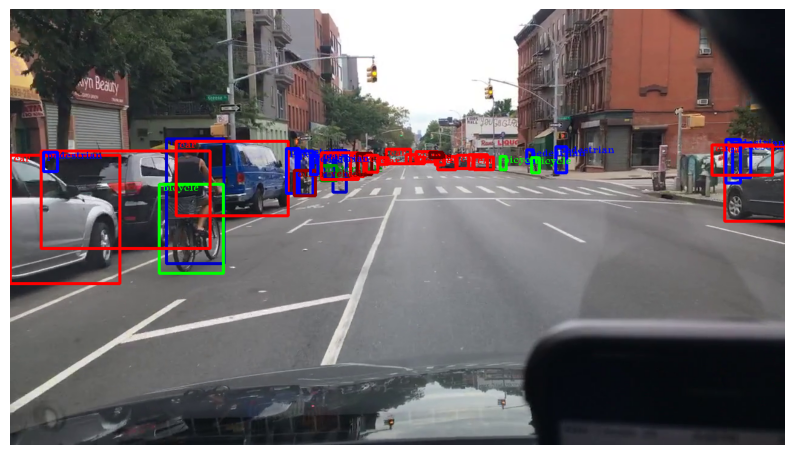

In [87]:
frame_labels = video_labels.query('video_frame == 1035')
font = cv2.FONT_HERSHEY_TRIPLEX
img_example = img.copy()

for i, d in frame_labels.iterrows():
  point1 = int(d['box2d.x1']), int(d['box2d.y1'])
  point2 = int(d['box2d.x2']), int(d['box2d.y2'])
  color = color_map[d['category']]
  img_example = cv2.rectangle(img_example, point1, point2, color, 3)
  pt_text = int(d['box2d.x1']) + 5, int(d['box2d.y1'] + 10)
  img_example = cv2.putText(img_example, d["category"], pt_text, font, 0.5, color)
display_cv2_img(img_example)
cap.release()

# Label and Output Annotated Video

In [88]:
def add_annotations(img, frame, video_labels):
    max_frame = video_labels.query("video_frame <= @frame")["video_frame"].max()
    frame_labels = video_labels.query("video_frame == @max_frame")
    for i, d in frame_labels.iterrows():
        pt1 = int(d["box2d.x1"]), int(d["box2d.y1"])
        pt2 = int(d["box2d.x2"]), int(d["box2d.y2"])
        color = color_map[d["category"]]
        img = cv2.rectangle(img, pt1, pt2, color, 3)
    return img

In [89]:
VIDEO_CODEC = "mp4v"
fps = 59.94
width = 1280
height = 720
out = cv2.VideoWriter("out_test.mp4",
                cv2.VideoWriter_fourcc(*VIDEO_CODEC),
                fps,
                (width, height))

cap = cv2.VideoCapture("026c7465-309f6d33.mp4")
n_frames = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))

for frame in tqdm(range(n_frames), total=n_frames):
    ret, img = cap.read()
    if ret == False:
        break
    img = add_annotations(img, frame, video_labels)
    out.write(img)
out.release()
cap.release()

  0%|          | 0/2398 [00:00<?, ?it/s]

In [90]:
!ls -GFlash -color

total 20G
 72M -rw------- 1 root  72M Jan 17 03:55 out_test.mp4
 29M -rw------- 1 root  29M Jan 17 03:52 out_test_compressed.mp4
 75M -rw------- 1 root  75M Jan 17 02:14 mot_labels.parquet
 83M -rw------- 1 root  83M Jan 17 00:29 mot_labels.csv.zip
442M -rw------- 1 root 442M Jan 17 03:53 mot_labels.csv
 19G -rw------- 1 root  19G Jan 17 02:41 driving-video-with-object-tracking.zip
4.0K drwx------ 3 root 4.0K Jan 17 02:03 bdd100k_videos_train_00/
 14M -rw------- 1 root  14M Jan 17 03:54 026c7465-309f6d33.mp4


In [91]:
tmp_output_path = "out_test.mp4"
output_path = "out_test_compressed.mp4"
subprocess.run(
    [
        "ffmpeg",
        "-i",
        tmp_output_path,
        "-crf",
        "18",
        "-preset",
        "veryfast",
        "-vcodec",
        "libx264",
        output_path,
        '-loglevel',
        'quiet'
    ]
)

CompletedProcess(args=['ffmpeg', '-i', 'out_test.mp4', '-crf', '18', '-preset', 'veryfast', '-vcodec', 'libx264', 'out_test_compressed.mp4', '-loglevel', 'quiet'], returncode=1)

In [92]:
!ls -GFlash --color

total 20G
 14M -rw------- 1 root  14M Jan 17 02:18 026c7465-309f6d33.mp4
4.0K drwx------ 3 root 4.0K Jan 17 02:03 bdd100k_videos_train_00/
 19G -rw------- 1 root  19G Jun  1  2022 driving-video-with-object-tracking.zip
442M -rw------- 1 root 442M Jun  1  2022 mot_labels.csv
 83M -rw------- 1 root  83M Jan 17 00:28 mot_labels.csv.zip
 75M -rw------- 1 root  75M Jun  1  2022 mot_labels.parquet
 29M -rw------- 1 root  29M Jan 17 03:51 out_test_compressed.mp4
 72M -rw------- 1 root  72M Jan 17 03:55 out_test.mp4


In [95]:
# ipd.Video('out_test_compressed.mp4', width=600)

In [96]:
# watch the selected video

from IPython.display import HTML
from base64 import b64encode
mp4 = open('out_test_compressed.mp4','rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML("""
<video width=600 controls>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)